In [191]:
import os
import cv2
import matplotlib.pyplot as plt
from random import randrange
import numpy as np
import random
import math
from dtw import dtw
%matplotlib inline

# Q1 Image Mosaicing

In [20]:
images_folder = ["1_1.jpg","1_2.jpg","1_3.jpg","1_4.jpg","2_1.png","2_2.png","2_3.png","2_4.png",
                 "2_5.png","2_6.png","3_1.png","3_2.png","4_1.jpg","4_2.jpg","5_1.jpg","5_2.jpg",
                 "5_3.jpg",'5_4.jpg']
     
img_cvRead=[]
IMAGES_FOLDER_PATH = "../images/Image Mosaicing/"
for i in images_folder:
    img = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,i))
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_cvRead.append(rgb)

In [21]:
def plot_image(img1,img2,title1,title2,color):
    fig = plt.figure(figsize=(20,10))
    plt.subplot(121)
    plt.title(title1, fontsize=25, color=color) 
    plt.imshow(img1)
    plt.subplot(122)
    plt.title(title2, fontsize=25, color=color)
    plt.imshow(img2)
    plt.show()

### 1.1 Matches between twopartially overlapping images

In [22]:
def find_X_x(img1,img2):
    orb = cv2.ORB_create()
    qp1,dp1 = orb.detectAndCompute(img1,None)
    qp2,dp2 = orb.detectAndCompute(img2,None)
    matcher = cv2.BFMatcher()
    matches = matcher.knnMatch(dp1,dp2,2)
    pts1,pts2,good_matches = ([], ) * 3
    for m,n in matches:
        m.distance < 0.8*n.distance
        good_matches.append(m)
    pts1 = np.array([ qp1[m.queryIdx].pt for m in good_matches]).astype(np.float32)
    pts2 = np.array([ qp2[m.trainIdx].pt for m in good_matches]).astype(np.float32)
    return pts1,pts2

### 1.2 Computing Homography Matrix Using RANSAC with 8point algorithm

In [23]:
def Dlt(X,x):
    l = len(X)
    M = np.zeros((l*2,9))
    for i in range(0,l):
        M[2*i]=np.array([-X[i][0],-X[i][1],-1,0,0,0,X[i][0]*x[i][0],X[i][1]*x[i][0],x[i][0]])
        M[2*i+1]=np.array([0,0,0,-X[i][0],-X[i][1],-1,X[i][0]*x[i][1],X[i][1]*x[i][1],x[i][1]])
    try:
        U, S, V = np.linalg.svd(M)
        V = V[8,:].reshape((3,3))
        H = V/V[2,2]
        return H
    except:
        return None

def calMSe(x_predict,x):
    error = 0
    for i in range(len(x)):
        error =error + np.sqrt(((x_predict[i][0]-x[i][0])**2 + (x_predict[i][1]-x[i][1])**2))
    error = error/len(x)
    return error

def predictImgpoint(P,X):
    X =np.c_[X,np.ones(len(X))]
    predicted_x=[]
    for i in range(len(X)):
        xw=np.dot(P,X[i])
        x_predicted = xw[0]/xw[2]
        y_predicted = xw[1]/xw[2]
        predicted_x.append([x_predicted,y_predicted])
    return np.array(predicted_x) 

def RANSAC(X,x,itr):
    optimal_P =[]
    min_err = np.inf
    for i in range(itr):
        num_list = list(range(len(X)))
        ind_for_com = []
        val = 0
        while val < 10:
            l=len(num_list)-1
            randnum = random.randint(0,l)
            ind_for_com.append(num_list[randnum])
            num_list.remove(num_list[randnum])
            val+=1
        X_w,x_i = ([],)*2
        for j in range(len(ind_for_com)):
            X_w.append(X[ind_for_com[j]])
            x_i.append(x[ind_for_com[j]])
        X_w=np.array(X_w)
        x_i=np.array(x_i)
        P = Dlt(X_w,x_i)
        if P is None:
            continue
        x_predict_I = predictImgpoint(P,X_w)
        error = calMSe(x_predict_I,x_i)
        if error < min_err:
            min_err = error
            optimal_P = P
    return optimal_P

In [24]:
def remove_black_pixel(img):
    sz1 = 0
    height,width = img.shape[0:2]
    for j in range(0,width):
        c = 0
        for i in range(0,height):
            if img[i][j][0] != 0 or img[i][j][1] != 0 or img[i][j][2] != 0:
                c += 1
            else:
                break
        if sz1<c:
            sz1=c
    sz2 = 0
    for i in range(0, height):
        c = 0
        for j in range(0,width):
            if img[i][j][0] != 0 or img[i][j][1] != 0 or img[i][j][2] != 0:
                c += 1
            else:
                break
        if sz2<c:
            sz2=c
    img = img[0:sz1, 0 : sz2, :]
    return img

### 1.3 & 1.4 Transforming  one of the images to the other’s reference frame and  Stitch the two images 

In [25]:
def compute_mosiac_img(img1,img2,pts1,pts2,itr):
    M = RANSAC(pts1,pts2,itr)
    H,mask = cv2.findHomography(pts2,pts1,cv2.RANSAC,5.0)
    size = (img2.shape[1]+img1.shape[1],2*min(img2.shape[0],img1.shape[0]))
    dst = cv2.warpPerspective(img2,H,size)
    dst[0:img1.shape[0], 0:img1.shape[1]] = img1
    dst = remove_black_pixel(dst)
    return dst

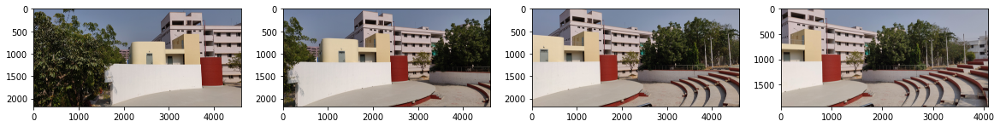

In [10]:
fig = plt.figure(figsize = (20,10))
plt.subplot(141)
plt.imshow(img_cvRead[0])
plt.subplot(142)
plt.imshow(img_cvRead[1])
plt.subplot(143)
plt.imshow(img_cvRead[2])
plt.subplot(144)
plt.imshow(img_cvRead[3])
plt.show()

## 1.5 Using multiple overlaped images to produce a singly mosaic/panorama

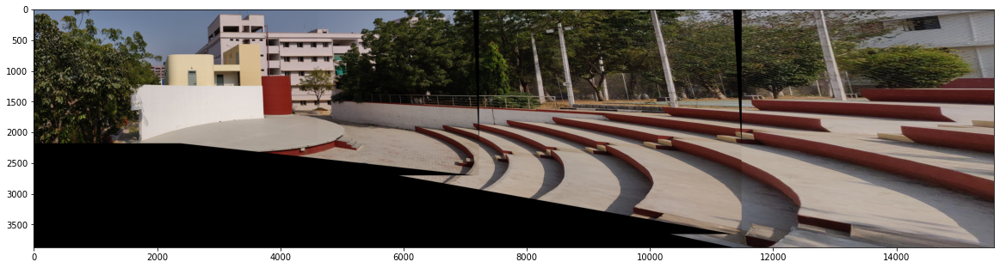

In [19]:
pts1,pts2 = find_X_x(img_cvRead[0],img_cvRead[1])
imgA = compute_mosiac_img(img_cvRead[0],img_cvRead[1],pts1,pts2,1000)

pts1,pts2 = find_X_x(imgA,img_cvRead[2])
imgB = compute_mosiac_img(imgA,img_cvRead[2],pts1,pts2,1000)

pts1,pts2 = find_X_x(imgB,img_cvRead[3])
imgC = compute_mosiac_img(imgB,img_cvRead[3],pts1,pts2,1000)
fig = plt.figure(figsize = (20,10))
plt.imshow(imgC)

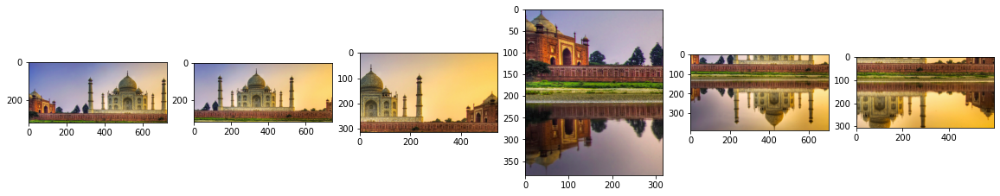

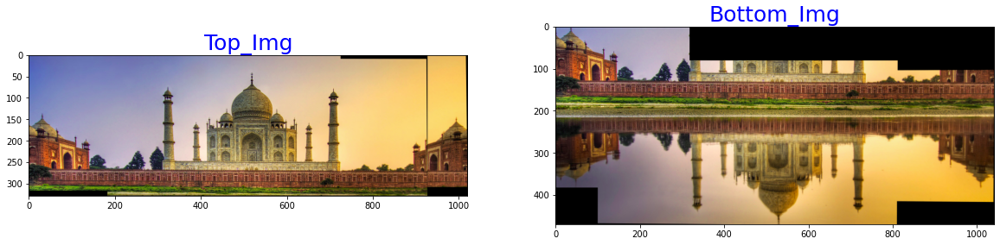

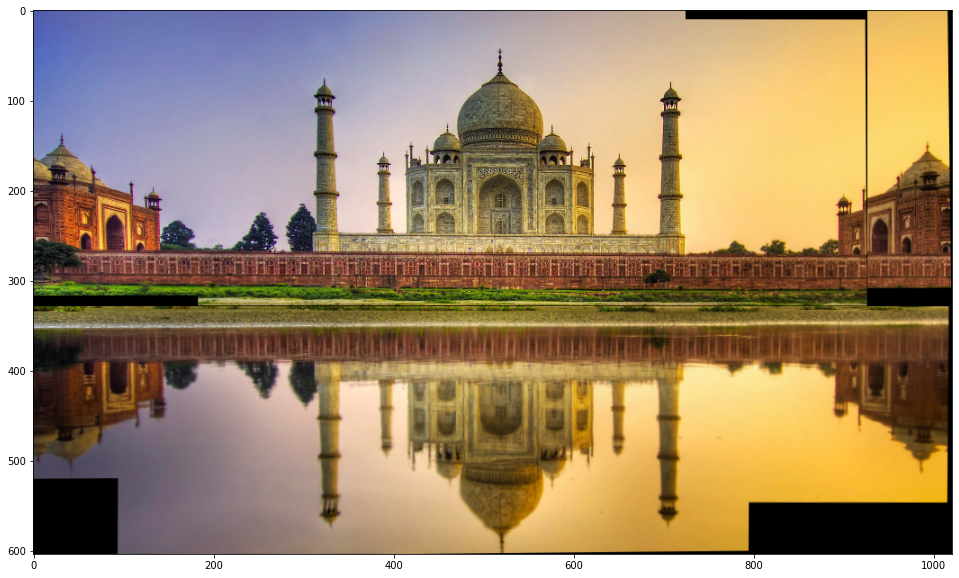

In [20]:
fig = plt.figure(figsize = (20,10))
plt.subplot(161)
plt.imshow(img_cvRead[4])
plt.subplot(162)
plt.imshow(img_cvRead[5])
plt.subplot(163)
plt.imshow(img_cvRead[6])
plt.subplot(164)
plt.imshow(img_cvRead[7])
plt.subplot(165)
plt.imshow(img_cvRead[8])
plt.subplot(166)
plt.imshow(img_cvRead[9])
plt.show()

pts1,pts2 = find_X_x(img_cvRead[4],img_cvRead[5])
imgA = compute_mosiac_img(img_cvRead[4],img_cvRead[5],pts1,pts2,500)

pts1,pts2 = find_X_x(imgA,img_cvRead[6])
img_top = compute_mosiac_img(imgA,img_cvRead[6],pts1,pts2,500)

pts1,pts2 = find_X_x(img_cvRead[8],img_cvRead[9])
imgB = compute_mosiac_img(img_cvRead[8],img_cvRead[9],pts1,pts2,500)

pts1,pts2 = find_X_x(img_cvRead[7],imgB)
img_Bottom = compute_mosiac_img(img_cvRead[7],imgB,pts1,pts2,500)

pts1,pts2 = find_X_x(img_top,img_Bottom)
imgC = compute_mosiac_img(img_top,img_Bottom,pts1,pts2,500)

plot_image(img_top,img_Bottom,"Top_Img","Bottom_Img",color="blue")
fig = plt.figure(figsize = (20,10))
plt.imshow(imgC)
plt.show()

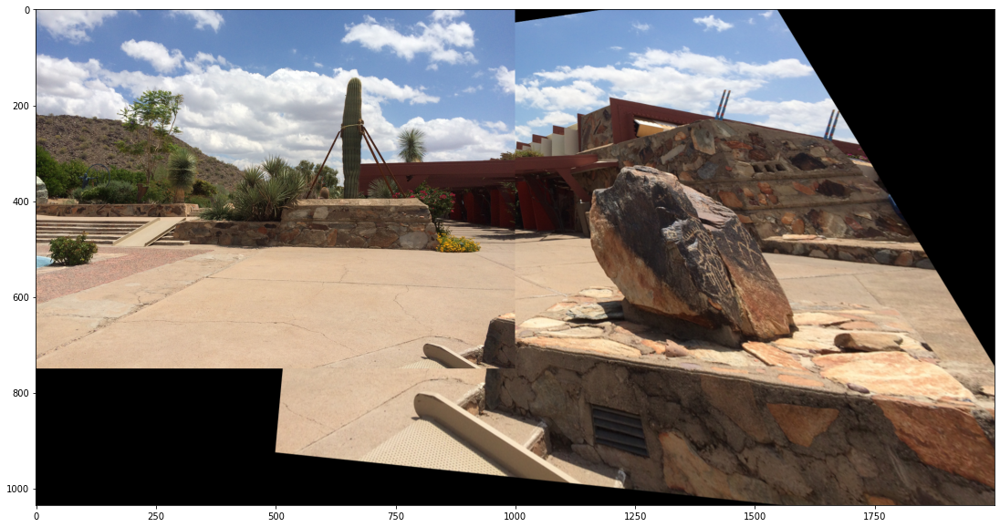

In [21]:
pts1,pts2 = find_X_x(img_cvRead[10],img_cvRead[11])
imgA = compute_mosiac_img(img_cvRead[10],img_cvRead[11],pts1,pts2,500)

fig = plt.figure(figsize = (20,10))
plt.imshow(imgA)

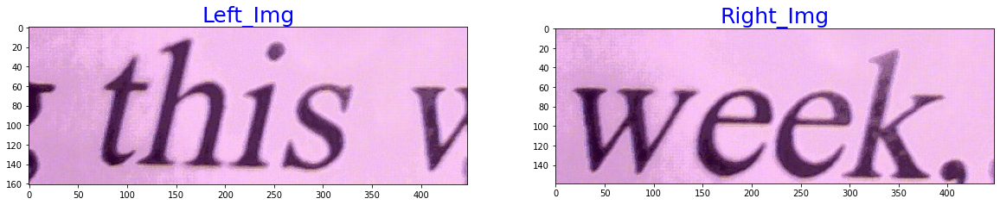

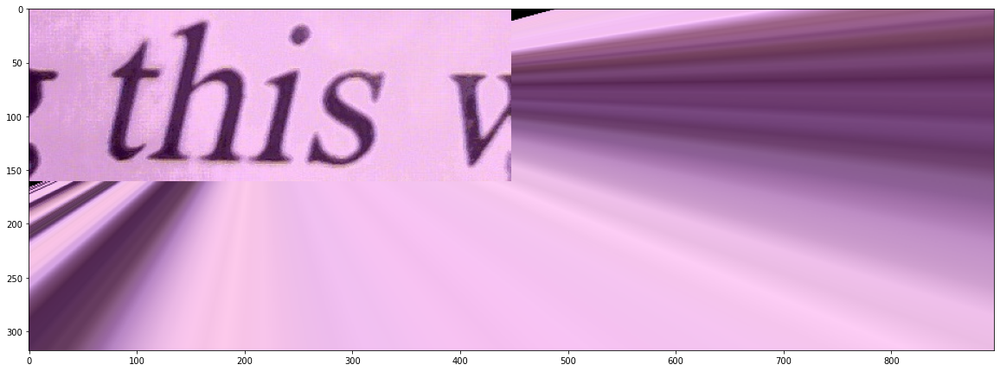

In [67]:
pts1,pts2 = find_X_x(img_cvRead[12],img_cvRead[13])
imgA = compute_mosiac_img(img_cvRead[12],img_cvRead[13],pts1,pts2,1000)

fig = plt.figure(figsize = (20,10))
plt.imshow(imgA)
plt.show()

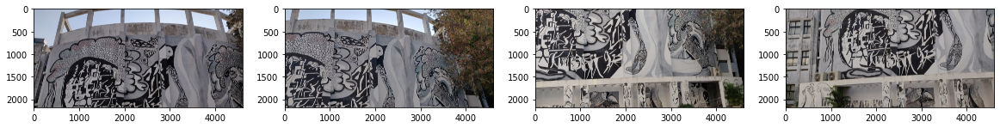

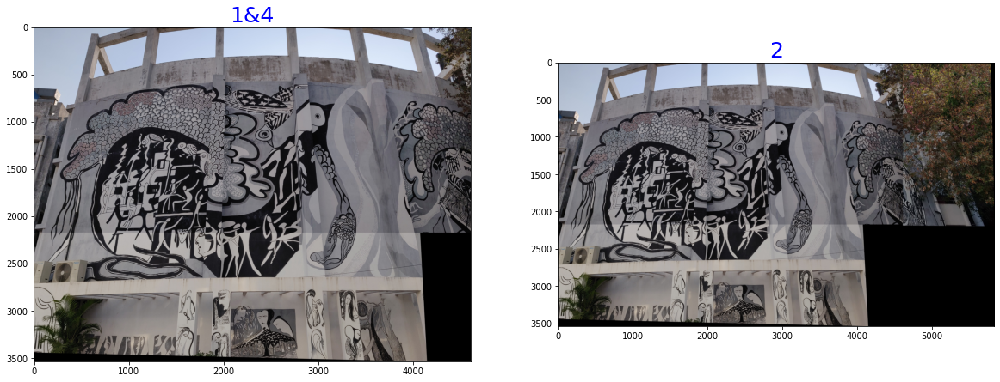

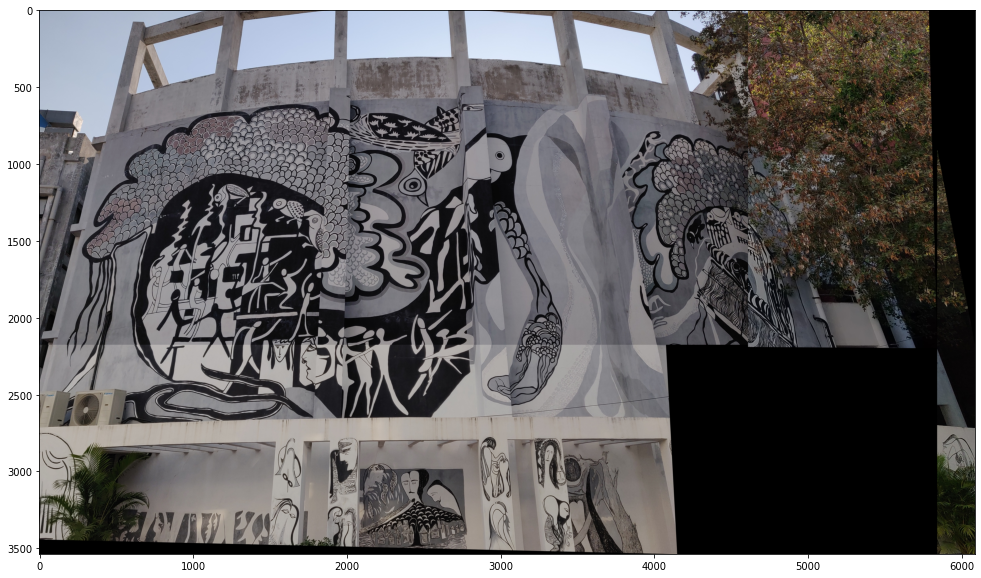

In [114]:
fig = plt.figure(figsize = (20,10))
plt.subplot(141)
plt.imshow(img_cvRead[14])
plt.subplot(142)
plt.imshow(img_cvRead[15])
plt.subplot(143)
plt.imshow(img_cvRead[16])
plt.subplot(144)
plt.imshow(img_cvRead[17])
plt.show()
pts1,pts2 = find_X_x(img_cvRead[14],img_cvRead[17])
imgT = compute_mosiac_img(img_cvRead[14],img_cvRead[17],pts1,pts2,500)

pts1,pts2 = find_X_x(imgT,img_cvRead[15])
imgB = compute_mosiac_img(imgT,img_cvRead[15],pts1,pts2,500)

plot_image(imgT,imgB,"1&4","1&4&2",color="blue")
pts1,pts2 = find_X_x(imgB,img_cvRead[16])
imgC = compute_mosiac_img(imgB,img_cvRead[16],pts1,pts2,500)
fig = plt.figure(figsize = (20,10))
plt.imshow(imgC)
plt.show()

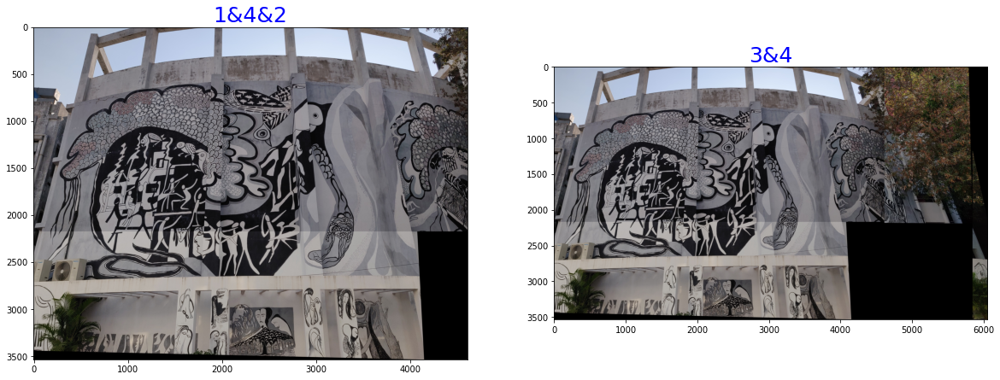

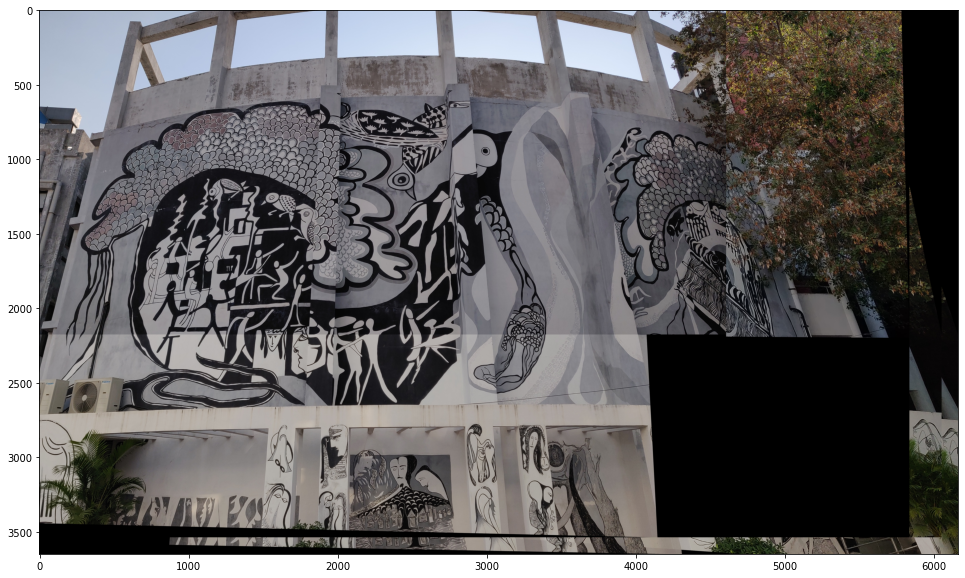

In [115]:
pts1,pts2 = find_X_x(img_cvRead[16],img_cvRead[17])
imgA = compute_mosiac_img(img_cvRead[16],img_cvRead[17],pts1,pts2,500)

pts1,pts2 = find_X_x(imgB,imgA)
imgB = compute_mosiac_img(imgB,imgA,pts1,pts2,500)

plot_image(imgT,imgB,"1&4&2","3&4",color="blue")
pts1,pts2 = find_X_x(imgB,imgA)
imgC = compute_mosiac_img(imgB,imgA,pts1,pts2,500)
fig = plt.figure(figsize = (20,10))
plt.imshow(imgC)
plt.show()

here we see that if change the order of image we get the different.Some part of images are not selected in the final image.

## 1.7  overlapping images of a scene with own camera 

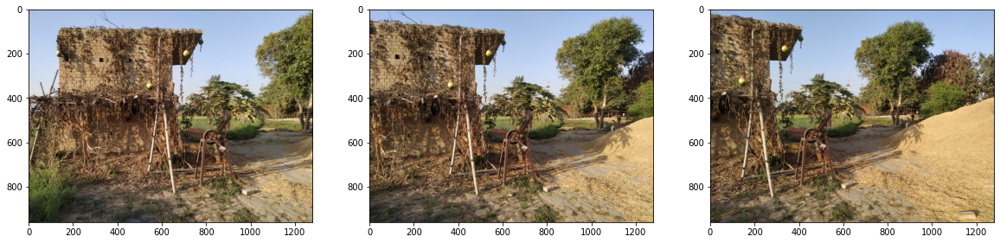

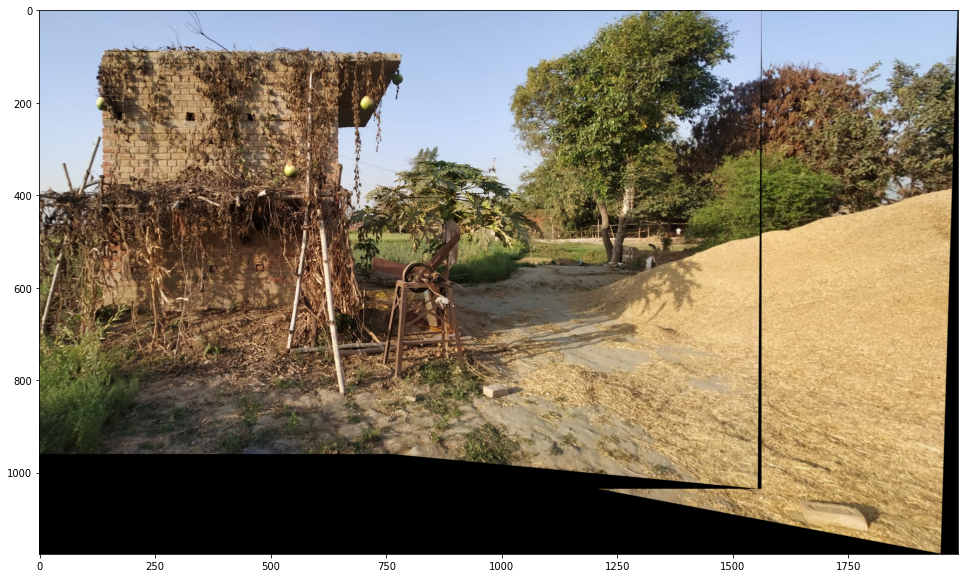

In [11]:
IMAGES_FOLDER_PATH = "../images/my_own_cam/"
imgB1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1.jpeg"))
imgB1 = cv2.cvtColor(imgB1, cv2.COLOR_BGR2RGB)
imgB2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2.jpeg"))
imgB2 = cv2.cvtColor(imgB2, cv2.COLOR_BGR2RGB)
imgB3 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3.jpeg"))
imgB3 = cv2.cvtColor(imgB3, cv2.COLOR_BGR2RGB)

fig = plt.figure(figsize=(20,10))
plt.subplot(131)
plt.imshow(imgB1)
plt.subplot(132)
plt.imshow(imgB2)
plt.subplot(133)
plt.imshow(imgB3)
plt.show()

pts1,pts2 = find_X_x(imgB1,imgB2)
imgF1 = compute_mosiac_img(imgB1,imgB2,pts1,pts2,1000)

pts1,pts2 = find_X_x(imgF1,imgB3)
imgF = compute_mosiac_img(imgF1,imgB3,pts1,pts2,1000)

fig = plt.figure(figsize=(20,10))
plt.imshow(imgF)

# Q2 Stereo Correspondences
#### 1. Intensity window-based correlation


In [121]:
IMAGES_FOLDER_PATH = "../images/Stereo Correspondence"

img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

In [230]:
def correlation(A,B):
    A = A.flatten()
    B = B.flatten()
    A_mean = A.mean()
    B_mean = B.mean()
    A = A-A_mean
    B = B-B_mean
    val_num = np.sum(np.dot(A,B))
    val_denum =np.sqrt(np.sum(A**2)*np.sum(B**2))
    return val_num/val_denum

In [123]:
def compute_match(imgL,imgR,window_Size=100,Stride=100):
    R1,C1 = imgL.shape[0:2]
    R2,C2 = imgR.shape[0:2]
    best_matches = []
    for i in range(0,R1-window_Size,Stride):
        for j in range(0,C1-window_Size,Stride):
            max_corr = 0.4
            p_list = []
            D1 = imgL[i:i+window_Size,j:j+window_Size,:]
            for p in range(0,R2-window_Size,Stride):
                for q in range(0,C2-window_Size,Stride):
                    D2 = imgR[p:p+window_Size,q:q+window_Size,:]
                    corr = correlation(D1,D2)
                    if corr > max_corr:
                        max_corr = corr
                        p_list = [j,i,q,p]      
            if (p_list):
                best_matches.append(p_list)
            else: 
                continue
    return best_matches

In [124]:
def draw_line(Img,mat,Window_size,thickness,color):
    R,C = Img.shape[0:2]
    final_img = None
    for point in mat:
        P1 = (point[1] + Window_size // 2 ,point[0] + Window_size // 2 )
        P2 = (point[3] +C//2+ Window_size // 2,point[2]+ Window_size // 2)
        if P1[1]<R and P1[0]<C//2 and P2[1]<R and P2[0]<C and P2[0]>C//2:
            color = tuple(np.random.randint(0,255,3).tolist())
            final_img = cv2.line(Img,P1,P2,color, thickness)
            final_img = cv2.circle(Img,P1,5,color,-1)
            final_img = cv2.circle(Img,P2,5,color,-1)
    fig = plt.figure(figsize=(20,10))
    plt.imshow(final_img)
    plt.show()

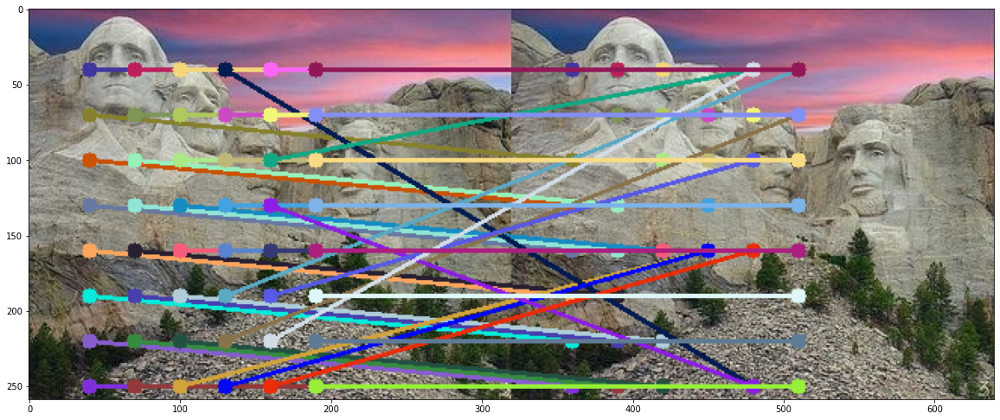

In [172]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
img = np.concatenate((img1, img2), axis=1)
# fig = plt.figure(figsize=(20,10))
# plt.imshow(img)

matches  = compute_match(img1,img2,80,30)
draw_line(img,matches,80,2,(255,0,0))


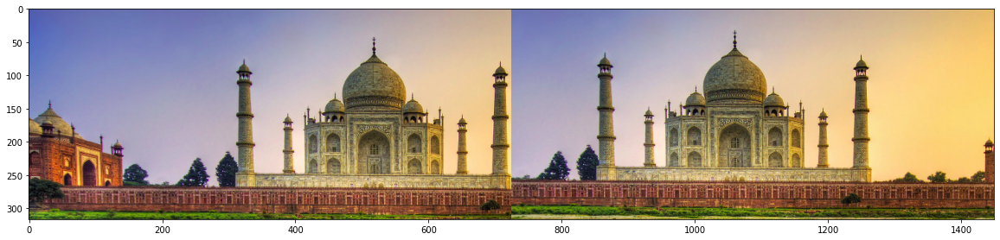

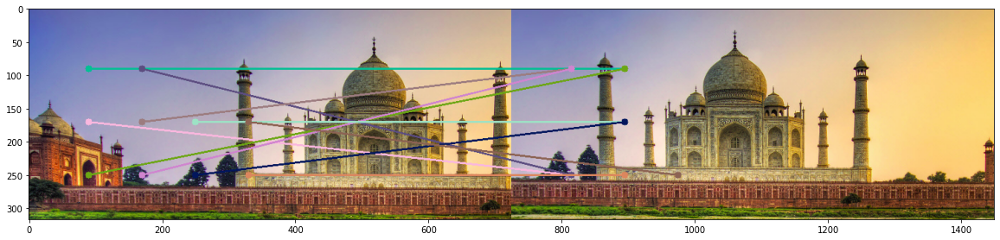

In [118]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_1.png"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_2.png"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

h1,w1 = img1.shape[0:2]
h2,w2 = img2.shape[0:2]
h_min = min(h1,h2)
w_min = min(w1,w2)
##coverting the both image as same size
img_1 = img1[0:h_min,0:w_min]
img_2 = img2[0:h_min,0:w_min]
img = np.concatenate((img_1, img_2), axis=1)
fig = plt.figure(figsize=(20,10))
plt.imshow(img)
plt.show()
match  = compute_match(img_1,img_2,20,80)
draw_line(img,match,180,2,(0,255,255))

<ipython-input-27-bebe5c133840>:11: RuntimeWarning: invalid value encountered in double_scalars
  return val_num/val_denum


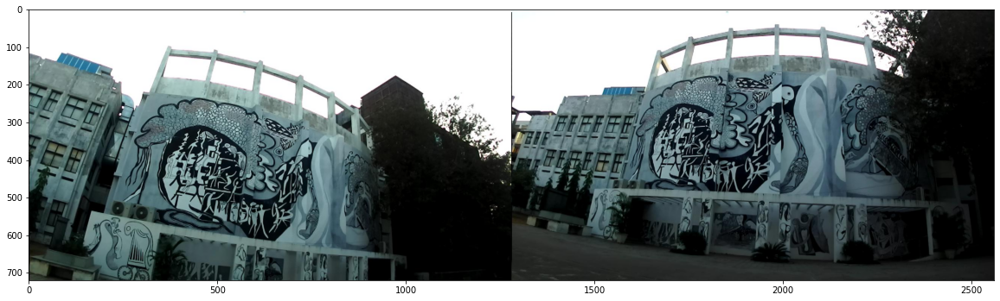

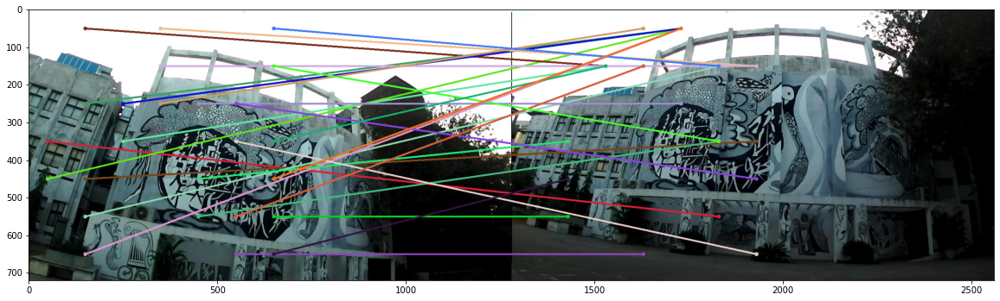

In [39]:
img3_1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_1.jpg"))
img3_1 = cv2.cvtColor(img3_1,cv2.COLOR_BGR2RGB)

img3_2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_2.jpg"))
img3_2 = cv2.cvtColor(img3_2,cv2.COLOR_BGR2RGB)

# plot_image(img3_1,img3_2,"Left_Img","Right_Img",color="blue")
imgD = np.concatenate((img3_1, img3_2), axis=1)
fig = plt.figure(figsize=(20,10))
plt.imshow(imgD)

matches  = compute_match(img3_1,img3_2,100,100)
draw_line(imgD,matches,100,3,(255,0,0))

### 2.5(BONUS) shift based matching 

In [125]:
def construct_shiftBased_match(img1,img2):
    pts1,pts2 = find_X_x(img1,img2)

    pts1 = np.array(pts1).astype(np.int32)
    pts2 = np.array(pts2).astype(np.int32)

    matches = []
    img = np.concatenate((img1, img2), axis=1)
    ## here only matched <=100 line because it become more dense 
    l = len(pts1)
    if l> 200:
        for i in range(0,200):
            matches.append([pts1[i][0],pts2[i][1],pts2[i][0],pts2[i][1]])
    else:
        for i in range(0,l):
            matches.append([pts1[i][0],pts2[i][1],pts2[i][0],pts2[i][1]])
    draw_line(img,matches,2,1,(0,0,255))

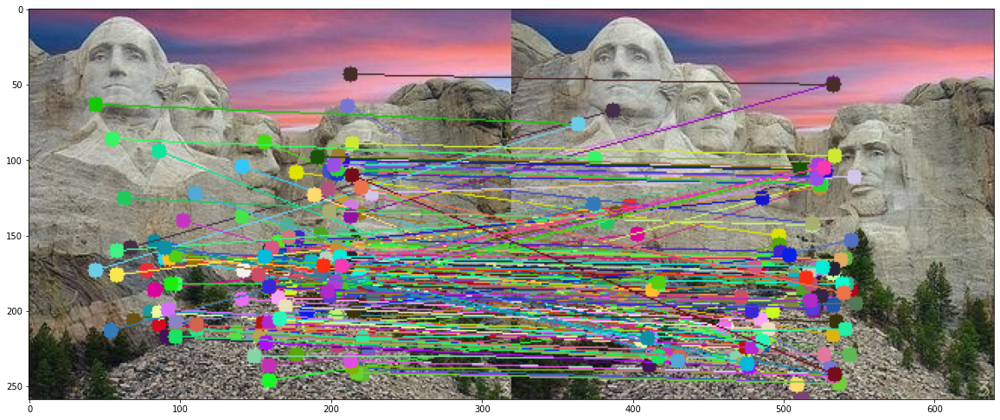

In [41]:
IMAGES_FOLDER_PATH = "../images/Stereo Correspondence"

img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

construct_shiftBased_match(img1,img2)

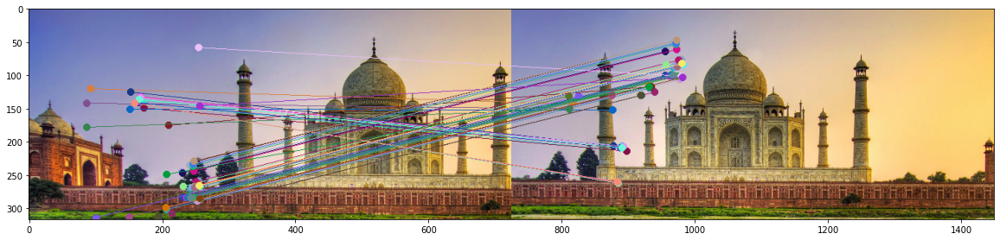

In [31]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_1.png"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_2.png"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

h1,w1 = img1.shape[0:2]
h2,w2 = img2.shape[0:2]
h_min = min(h1,h2)
w_min = min(w1,w2)
##coverting the both image as same size
img_1 = img1[0:h_min,0:w_min]
img_2 = img2[0:h_min,0:w_min]

construct_shiftBased_match(img_1,img_2)

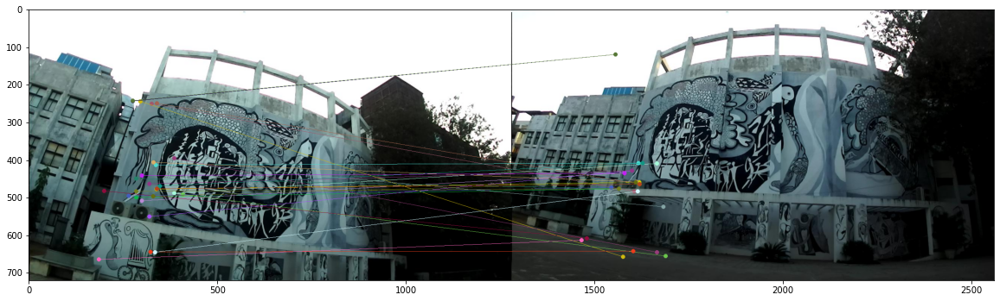

In [32]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

construct_shiftBased_match(img1,img2)

 ### 2.2 Epiploar Line

In [126]:
def NormalisePoint(x_image):
    d =[]
    x_mean = 0
    y_mean = 0
    x_norm = []
    y_norm = []
    for i in range(len(x_image)):
        x_mean+=x_image[i][0]
        y_mean+=x_image[i][1]
    x_mean =x_mean/len(x_image)
    y_mean = y_mean/len(x_image)
    #print(x_mean,y_mean)
    for i in range(len(x_image)):
        x_norm.append(x_image[i][0]-x_mean)
        y_norm.append(x_image[i][1]-y_mean)
    for x,y in zip(x_norm,y_norm):
        d.append(np.sqrt(x**2 + y**2))
    d_mean = np.mean(d)
    #print(d_mean)
    D = np.sqrt(2)/d_mean
    T = [[D,0,-1*D*x_mean],[0,D,-1*D*y_mean],[0,0,1]]
    x_norm_point = np.c_[x_image,np.ones(len(x_image))]
    for i in range(len(x_norm_point)):
        x_norm_point[i]=np.dot(T,x_norm_point[i])   
    x_norm_point = np.delete(x_norm_point,-1,axis=1)
    return np.array(x_norm_point)

In [127]:
def fundamentalMat(X,x):
    l = len(X)
    M = np.zeros((l,9))
    for i in range(l):
        M[i][0] = x[i][0]*X[i][0]
        M[i][1] = x[i][0]*X[i][1]
        M[i][2] = x[i][0]
        M[i][3] = X[i][1]*X[i][0]
        M[i][4] = x[i][1]*X[i][1]
        M[i][5] = x[i][1]
        M[i][6] = X[i][0]
        M[i][7] = X[i][1]
        M[i][8] = 1
    M = np.array(M)
    try:
        U, S, V = np.linalg.svd(M)
        F = V[8,:].reshape((3,3))
        return F
    except:
        return None

In [128]:
def drawlines(img1,img2,lines,pts1,pts2,thickness=1):
    r,c = img1.shape[0:2]
    for r,pt1,pt2 in zip(lines,pts1,pts2):
        color = tuple(np.random.randint(0,255,3).tolist())
        x0,y0 = map(int, [0, -r[2]/r[1] ])
        x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
        img1 = cv2.line(img1, (x0,y0), (x1,y1), color,thickness)
        img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
        img2 = cv2.circle(img2,tuple(pt2),5,color,-1)
    return img2

In [129]:
def F_RANSAC(X,x,itr):
    optimal_P =[]
    min_err = np.inf
    for i in range(itr):
        num_list = list(range(len(X)))
        ind_for_com = []
        val = 0
        while val < 9:
            l=len(num_list)-1
            randnum = random.randint(0,l)
            ind_for_com.append(num_list[randnum])
            num_list.remove(num_list[randnum])
            val+=1
        X_w,x_i = ([],)*2
        for j in range(len(ind_for_com)):
            X_w.append(X[ind_for_com[j]])
            x_i.append(x[ind_for_com[j]])
        X_w=np.array(X_w)
        x_i=np.array(x_i)
        P = fundamentalMat(X_w,x_i)
        if P is None:
            continue
        x_predict_I = predictImgpoint(P,X_w)
        error = calMSe(x_predict_I,x_i)
        if error < min_err:
            min_err = error
            optimal_P = P
    return optimal_P

In [130]:
def construct_EpipoleLine(img1,img2,thickness):
    p1,p2 = find_X_x(img1,img2)
    pts1 = []
    pts2 = []
    l = len(p1)
    for i in range(1,30):
        randnum = random.randint(0,l)
        pts1.append(p1[randnum])
        pts2.append(p2[randnum])
    pts1 = np.array(pts1)
    pts2 = np.array(pts2)

    F = fundamentalMat(pts1,pts2)

    opt_F = F_RANSAC(pts1,pts2,1000)

    lines1 = cv2.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2,opt_F)
    lines1 = lines1.reshape(-1,3)
    imgA = drawlines(img1,img2,lines1,pts1,pts2,thickness)

    lines2 = cv2.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1,opt_F)
    lines2 = lines2.reshape(-1,3)
    imgB = drawlines(img2,img1,lines2,pts2,pts1,thickness)

    plot_image(imgA,imgB,"Left_Img","Right_Img",color="blue")

<ipython-input-86-830ecd2f85bc>:8: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
<ipython-input-86-830ecd2f85bc>:9: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img2 = cv2.circle(img2,tuple(pt2),5,color,-1)


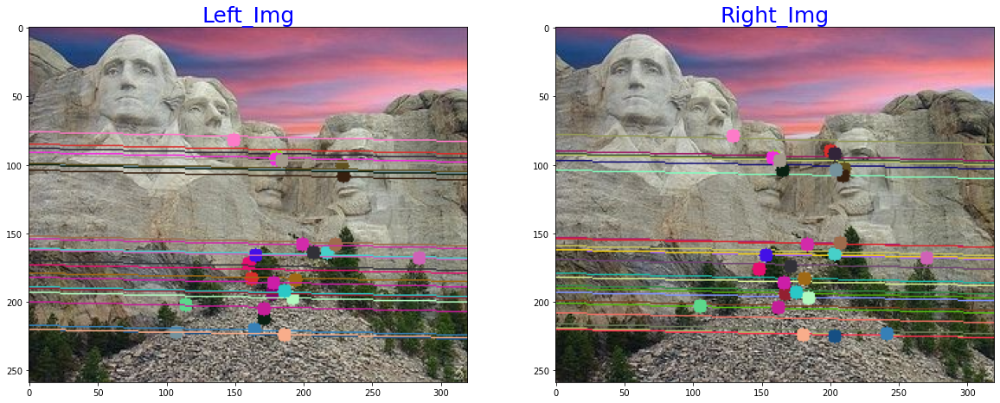

In [95]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

construct_EpipoleLine(img1,img2,1)

<ipython-input-35-830ecd2f85bc>:8: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
<ipython-input-35-830ecd2f85bc>:9: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img2 = cv2.circle(img2,tuple(pt2),5,color,-1)


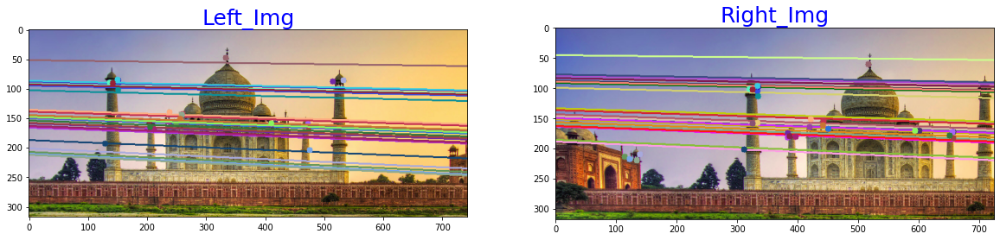

In [49]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_1.png"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_2.png"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

construct_EpipoleLine(img1,img2,2)

<ipython-input-35-830ecd2f85bc>:8: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
<ipython-input-35-830ecd2f85bc>:9: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img2 = cv2.circle(img2,tuple(pt2),5,color,-1)


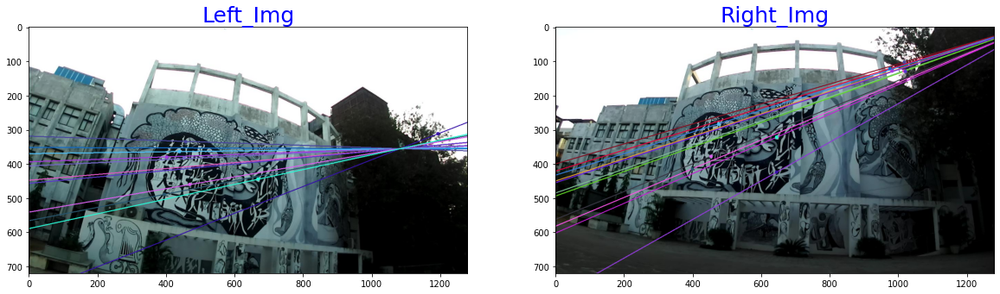

In [60]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_2.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_1.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
p1,p2 = find_X_x(img1,img2)
p11 = []
p22 = []
l = len(p1)
for i in range(0,50):
    randnum = random.randint(0,l)
    p11.append(p1[randnum])
    p22.append(p2[randnum])
p11 = np.array(p11)
p22 = np.array(p22)

F, mask = cv2.findFundamentalMat(p11,p22,cv2.RANSAC)
p11 = p11[mask.ravel()==1]
p22 = p22[mask.ravel()==1]

lines1 = cv2.computeCorrespondEpilines(p22.reshape(-1,1,2), 2,F)
lines1 = lines1.reshape(-1,3)
im1 = drawlines(img1,img2,lines1,p11,p22,2)
lines2 = cv2.computeCorrespondEpilines(p11.reshape(-1,1,2), 1,F)
lines2 = lines2.reshape(-1,3)
im2 =drawlines(img2,img1,lines2,p22,p11,2)
plot_image(im1,im2,"Left_Img","Right_Img",color="blue")

In [131]:
def construct_EpipoleLineS(img1,img2,thickness):
    pts1,pts2 = find_X_x(img1,img2)

    F,mask = cv2.findFundamentalMat(pts1,pts2,cv2.RANSAC)
    pts1 = pts1[mask.ravel()==1]
    pts2 = pts2[mask.ravel()==1]
    
    pts11 =np.c_[pts1,np.ones(len(pts1))]
    pts22 =np.c_[pts2,np.ones(len(pts2))]
    lines11 = np.dot(F,pts22.T)
    
    x1,y1 = lines11.shape
    lines11 = lines11.reshape(y1,x1)
    
    lines22 = np.dot(F.T,pts11.T)
    
    x2,y2 = lines22.shape
    lines22 = lines22.reshape(y1,x1)
    

    imgA = drawlines(img2,img1,lines11,pts1,pts2,thickness)

    imgB = drawlines(img1,img2,lines22,pts2,pts1,thickness)

    plot_image(imgA,imgB,"Left_Img","Right_Img",color="blue")

In [132]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

##due to size increases of notebook so i commented below function.
# construct_EpipoleLineS(img1,img2,1)

## 2.3 Rectification...

In [133]:
def Rectification(img1,img2):
    pts1,pts2 = find_X_x(img1,img2)
    F,mask = cv2.findFundamentalMat(pts1,pts2,cv2.RANSAC)
    #inlier points
    pts1 = pts1[mask.ravel()==1]
    pts2 = pts2[mask.ravel()==1]
    
    _,H1,H2 = cv2.stereoRectifyUncalibrated(pts1,pts2,F,img1.shape[0:2])
    
    rectified_img1 = cv2.warpPerspective(img1,H1,img1.shape[0:2])
    rectified_img2 = cv2.warpPerspective(img2,H2,img1.shape[0:2])
    return rectified_img1,rectified_img2

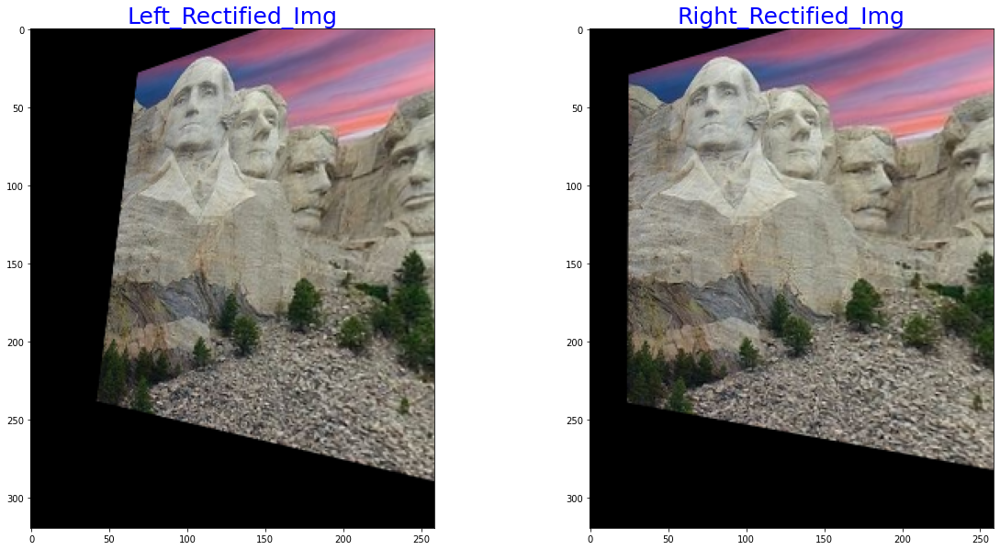

In [134]:
IMAGES_FOLDER_PATH = "../images/Stereo Correspondence"

img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

imgR1,imgR2 = Rectification(img1,img2)
plot_image(imgR1,imgR2,"Left_Rectified_Img","Right_Rectified_Img",color="blue")

## 2.4 Greedy based Matching

In [136]:
def find_inlier(X,x,itr,thresh):
    nOfinliers = 0
    inlierX = []
    inlierx = []
    for i in range(itr):
        num_list = list(range(len(X)))
        ind_for_com = []
        val = 0
        while val < 9:
            l=len(num_list)-1
            randnum = random.randint(0,l)
            ind_for_com.append(num_list[randnum])
            num_list.remove(num_list[randnum])
            val+=1
        X_w,x_i = ([],)*2
        for j in range(len(ind_for_com)):
            X_w.append(X[ind_for_com[j]])
            x_i.append(x[ind_for_com[j]])
        X_w=np.array(X_w)
        x_i=np.array(x_i)
        P = fundamentalMat(X_w,x_i)
        if P is None:
            continue
        X_w =np.c_[X_w,np.ones(len(X_w))]
        x_i =np.c_[x_i,np.ones(len(x_i))]
        for m,n in zip(X_w,x_i):
            cal_val = np.dot(np.dot(m,P),n.T)
            if cal_val<thresh:
                inlierX.append(m)
                inlierx.append(n)
                nOfinliers+=1
        return np.array(inlierX),np.array(inlierx),nOfinliers
    
def Find_Line(img1,img2):
    pts1,pts2 = find_X_x(img1,img2)
    F,mask = cv2.findFundamentalMat(pts1,pts2,cv2.RANSAC)
    pts1 = pts1[mask.ravel()==1]
    pts2 = pts2[mask.ravel()==1]
    pts11 =np.c_[pts1,np.ones(len(pts1))]
    pts22 =np.c_[pts2,np.ones(len(pts2))]
    lines11 = np.dot(F,pts22.T)
    lines11 = lines11.T 
    lines22 = np.dot(F,pts11.T)
    lines22 = lines22.T
    return lines11,lines22

In [302]:
def drawLine(Img,mat,Window_size,thickness,color):
    R,C = Img.shape[0:2]
    final_img = None
    for point in mat:
        P1 = (point[1]+ Window_size//2,point[0]+Window_size//2)
        P2 = (point[3] +C//2+Window_size//2,point[2]+Window_size//2)
        if P1[1]==P2[1] and P1[1]<R and P1[0]<C//2 and P2[1]<R and P2[0]<C and P2[0]>C//2:
            color = tuple(np.random.randint(0,255,3).tolist())
            final_img = cv2.line(Img,P1,P2,color, thickness)
            final_img = cv2.circle(Img,P1,5,color,-1)
            final_img = cv2.circle(Img,P2,5,color,-1)
    fig = plt.figure(figsize=(20,10))
    plt.imshow(final_img)
    plt.show()


def gredddyMatch(imgL,imgR,window_Size=100,Stride=100):
    R1,C1 = imgL.shape[0:2]
    R2,C2 = imgR.shape[0:2]
    best_matches = []
    for i in range(0,R1-window_Size,Stride):
        for j in range(0,C1-window_Size,Stride):
            max_corr = 0
            p_list = []
            D1 = imgL[i:i+window_Size,j:j+window_Size,:]
            for q in range(0,C2-window_Size,Stride):
                D2 = imgR[p:p+window_Size,q:q+window_Size,:]
                corr = correlation(D1,D2)
                if corr > max_corr:
                    max_corr = corr
                    p_list = [j,i,q,i]      
            if (p_list):
                best_matches.append(p_list)
            else: 
                continue
    return best_matches

<ipython-input-230-98f3606a157b>:10: RuntimeWarning: invalid value encountered in double_scalars
  return val_num/val_denum


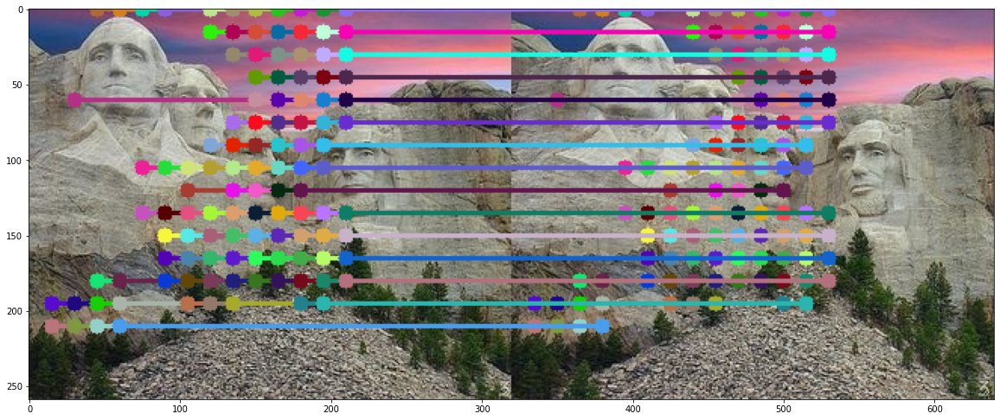

In [316]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
img = np.concatenate((img1, img2), axis=1)
# print(img.shape)
imgr1,imgr2 = Rectification(img1,img2)
matches = greedyMatch(imgr1,imgr2,40,15)
drawLine(img,matches,40,2,(255,0,0))

<ipython-input-230-98f3606a157b>:10: RuntimeWarning: invalid value encountered in double_scalars
  return val_num/val_denum


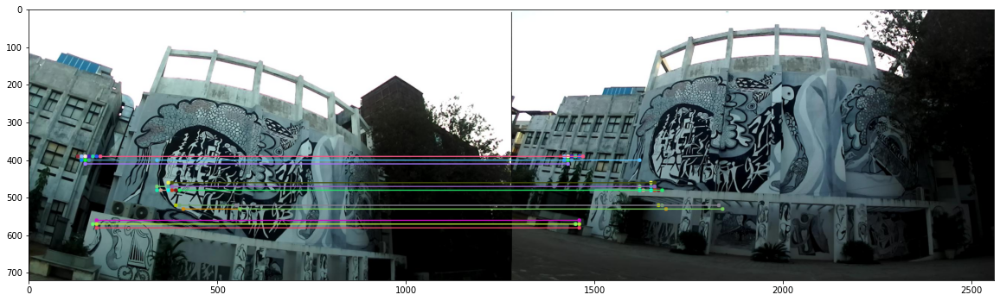

In [310]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"3_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
img = np.concatenate((img1, img2), axis=1)

imgr1,imgr2 = Rectification(img1,img2)
matches = greedyMatch(imgr1,imgr2,50,10)
# print(matches)
drawLine(img,matches,10,2,(255,0,0))

## Intensity based matching on rectified img

In [10]:
def Matching(img1,img2):
    img = np.concatenate((img1, img2), axis=1)
    imgR1,imgR2 = Rectification(img1,img2)
    matches = compute_match(imgR1,imgR2,window_Size=50,Stride=50)
    draw_line(img,matches,Window_size=50,thickness=2,color=(0,255,0))

<ipython-input-122-bebe5c133840>:11: RuntimeWarning: invalid value encountered in double_scalars
  return val_num/val_denum


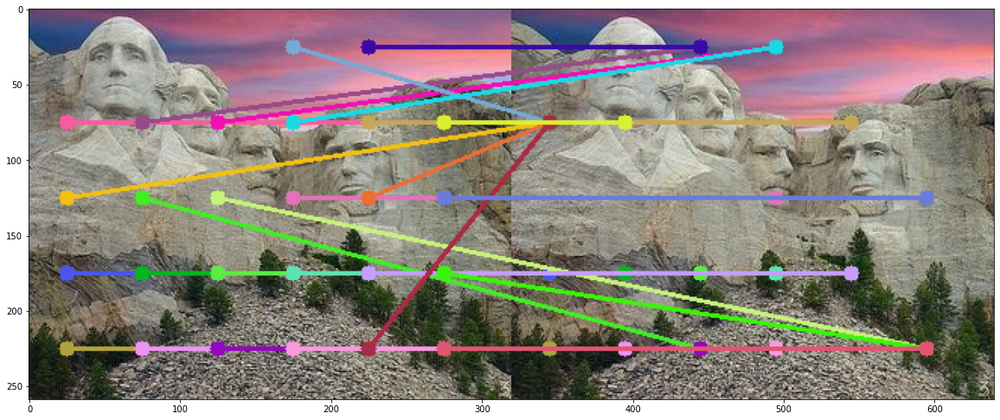

In [170]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

Matching(img1,img2)

## shift based matching on rectified img

In [9]:
def ShiftMatching(pts1,pts2,img1,img2):
    pts1 = np.array(pts1).astype(np.int32)
    pts2 = np.array(pts2).astype(np.int32)

    matches = []
    img = np.concatenate((img1, img2), axis=1)
    ## here only matched <=100 line because it become more dense 
    l = len(pts1)
    if l> 100:
        for i in range(0,100):
            matches.append([pts1[i][0],pts2[i][1],pts2[i][0],pts2[i][1]])
    else:
        for i in range(0,l):
            matches.append([pts1[i][0],pts2[i][1],pts2[i][0],pts2[i][1]])
    draw_line(img,matches,2,1,(0,0,255))
    

In [168]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_1.jpg"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"1_2.jpg"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

imgR1,imgR2 = Rectification(img1,img2)

F, mask = cv2.findFundamentalMat(pts1,pts2,cv2.RANSAC)
pts1 = pts1[mask.ravel()==1]
pts2 = pts2[mask.ravel()==1]

lines1 = cv2.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2,F)
lines1 = lines1.reshape(-1,3)
im1 = drawlines(img1,img2,lines1,pts1,pts2,2)
lines2 = cv2.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1,F)
lines2 = lines2.reshape(-1,3)
im2 =drawlines(img2,img1,lines2,pts2,pts1,2)
# plot_image(im1,im2,"Left_Img","Right_Img",color="blue")

<ipython-input-128-830ecd2f85bc>:8: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
<ipython-input-128-830ecd2f85bc>:9: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img2 = cv2.circle(img2,tuple(pt2),5,color,-1)


##  Epipolar line based on the recified image point

<ipython-input-128-830ecd2f85bc>:8: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
<ipython-input-128-830ecd2f85bc>:9: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img2 = cv2.circle(img2,tuple(pt2),5,color,-1)


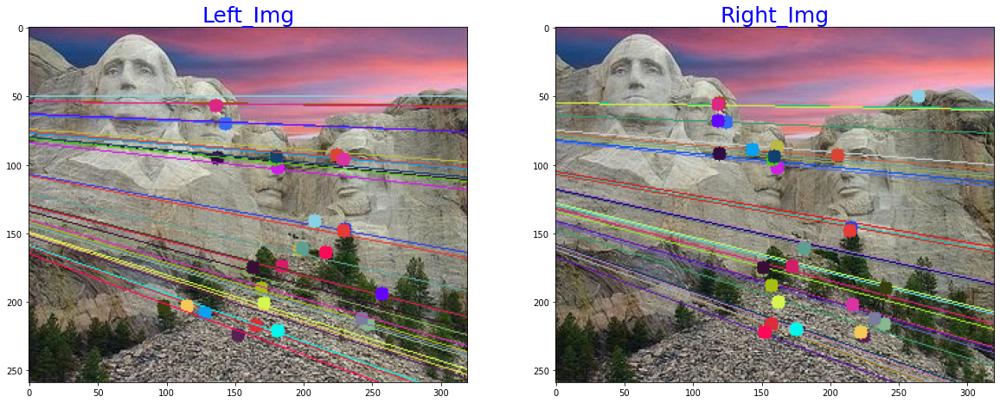

In [171]:
construct_EpipoleLine(img1,img2,1)

<ipython-input-128-830ecd2f85bc>:8: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img1 = cv2.circle(img1,tuple(pt1),5,color,-1)
<ipython-input-128-830ecd2f85bc>:9: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  img2 = cv2.circle(img2,tuple(pt2),5,color,-1)


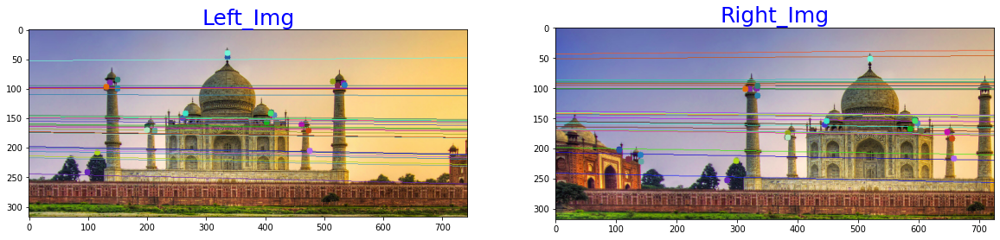

In [175]:
img1 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_1.png"))
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread(os.path.join(IMAGES_FOLDER_PATH,"2_2.png"))
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

imgR1,imgR2 = Rectification(img1,img2)
pts1,pts2 = find_X_x(imgR1,imgR2)

construct_EpipoleLine(img1,img2,1)